<a href="https://colab.research.google.com/github/federicocanzonieri/DeepLearning/blob/main/DeepLearning_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
NUM_EPOCHS=10

In [ ]:
!pip install pytorch_lightning

In [ ]:
import torch 
from torch import nn
from torchvision.datasets import MNIST
from torchvision import transforms
from torch.utils.data import DataLoader
from os.path import join 
from sklearn.metrics import accuracy_score
from torch.optim import SGD
import torch
import numpy as np
import random
import pytorch_lightning as pl
from pytorch_lightning.loggers import TensorBoardLogger
import numpy as np

np.random.seed(0)
torch.manual_seed(0)
random.seed(0)

In [ ]:
class MLPClassifier(nn.Module):
  def __init__(self, in_features, hidden_units, out_classes):
    """Costruisce un classificatore MLP.
    Input:
    in_features: numero di feature in input (es. 784)
    hidden_units: numero di unità nel livello nascosto (es. 512)
    out_classes: numero di classi in uscita (es. 10)"""
    super(MLPClassifier, self).__init__()
    self.hidden_layer = nn.Linear(in_features, hidden_units)
    self.activation = nn.Tanh()
    self.output_layer = nn.Linear(hidden_units, out_classes)

  def forward(self,x):
    hidden_representation = self.hidden_layer(x)
    hidden_representation = self.activation(hidden_representation)
    scores = self.output_layer(hidden_representation)
    return scores

transform=transforms.Compose([transforms.ToTensor(),
                              transforms.Normalize((0.1307,),(0.3081)),
                              transforms.Lambda(lambda x: x.view(-1))])

mnist_train = MNIST(root='data',train=True, download=True, transform=transform)
mnist_test = MNIST(root='data',train=False, download=True, transform=transform)

mnist_train_loader = DataLoader(mnist_train, batch_size=256, num_workers=4, shuffle=True)
mnist_test_loader = DataLoader(mnist_test, batch_size=256, num_workers=4)

device = "cuda" if torch.cuda.is_available() else "cpu"
model = MLPClassifier(784, 512, 10)

epochs=5

criterion = nn.CrossEntropyLoss()
optimizer = SGD(model.parameters(), lr=0.001) 

model.to(device)

for e in range(epochs):
  #training
  model.train()
  with torch.set_grad_enabled(True):
    for i, batch in enumerate(mnist_train_loader):
      x=batch[0].to(device) #portiamoli sul device corretto
      y=batch[1].to(device)
      output = model(x)
      l = criterion(output,y)
      l.backward()
      optimizer.step()
      optimizer.zero_grad()

      if i%100==0:
        print(f"[training] Eppoca: {e}/{epochs}. Iterazione: {i}/{len(mnist_train_loader)}. Loss: {l.item():0.2f}")

  all_predictions = []
  all_labels = []
  model.eval()
  with torch.set_grad_enabled(False):
    for i, batch in enumerate(mnist_train_loader):
      x=batch[0].to(device) #portiamoli sul device corretto
      y=batch[1].to(device)
      output = model(x)
      all_predictions.append(y.to('cpu').numpy())
      all_labels.append(output.to('cpu').max(1)[1].numpy())

  all_predictions = np.concatenate(all_predictions)
  all_labels = np.concatenate(all_labels)
  acc = accuracy_score(all_labels,all_predictions)



In [ ]:
%load_ext tensorboard
%tensorboard --logdir tb_logs

<IPython.core.display.Javascript object>

In [ ]:
import pytorch_lightning as pl
from pytorch_lightning.loggers import TensorBoardLogger
import numpy as np

logger=TensorBoardLogger("tb_logs",name="my_model")

transform=transforms.Compose([transforms.ToTensor(),
                              transforms.Normalize((0.1307,),(0.3081)),
                              transforms.Lambda(lambda x: x.view(-1))])

criterion = nn.CrossEntropyLoss()
optimizer = SGD(model.parameters(), lr=0.001) 

class MLPClassifier(pl.LightningModule):
  def __init__(self,in_features,hidden_units,out_classes):
    super(MLPClassifier,self).__init__()
    self.hidden_layer = nn.Linear(in_features,hidden_units)
    self.activation=nn.Tanh()
    self.output_layer=nn.Linear(hidden_units,out_classes)

  def forward(self,x):
    hidden_representation=self.hidden_layer(x)
    hidden_representation=self.activation(hidden_representation)
    scores=self.output_layer(hidden_representation)
    return scores
  
  def configure_optimizers(self):
    optmizer=SGD(self.parameters(),lr=0.001)
    return optmizer
  
  def training_step(self,train_batch,batch_idx):
    x,y=train_batch
    output=self.forward(x)
    loss=criterion(output,y)
    self.log('train/loss',loss)
    return loss

  def validation_step(self,val_batch,batch_idx):
    x,y=val_batch
    output=self.forward(x)
    acc=accuracy_score(y.cpu(),output.cpu().topk(1).indices)

    self.log('val/accuracy',acc)
    return {
        'predictions': output.cpu().topk(1).indices,
        'labels': y.cpu()
    }


  def validation_epoch_end(self,outputs):
    predictions=np.concatenate([ o['predictions'] for o in outputs])
    labels= np.concatenate([o['labels'] for o in outputs])
    acc=accuracy_score(labels,predictions)
    self.log('val/acc',acc)



mnist_train = MNIST(root='data',train=True, download=True, transform=transform)
mnist_val = MNIST(root='data',train=False, download=True, transform=transform)
mnist_train_loader = DataLoader(mnist_train, batch_size=256, num_workers=4, shuffle=True)
mnist_val_loader = DataLoader(mnist_val, batch_size=256, num_workers=4)

model = MLPClassifier(784, 512, 10)
trainer = pl.Trainer(max_epochs=5, gpus=1,logger=logger)
trainer.fit(model, mnist_train_loader, mnist_val_loader)
trainer.validate()




In [ ]:
!nvidia-smi

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



### **AUTOENCODERS**

In [ ]:
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader
from torchvision import transforms

transform = transforms.Compose([transforms.ToTensor(),transforms.Normalize((0.1307,), (0.3081,)),torch.flatten]) #flatten serve per convertire le immag
#ini in vettori di 784 unità
mnist_train = MNIST(root='mnist',train=True, download=True, transform=transform)
mnist_test = MNIST(root='mnist',train=False, download=True, transform=transform)

mnist_train_loader = DataLoader(mnist_train, batch_size=1024, num_workers=2, shuffle=True)
mnist_test_loader = DataLoader(mnist_test, batch_size=1024, num_workers=2)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting mnist/MNIST/raw/train-images-idx3-ubyte.gz to mnist/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting mnist/MNIST/raw/train-labels-idx1-ubyte.gz to mnist/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting mnist/MNIST/raw/t10k-images-idx3-ubyte.gz to mnist/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting mnist/MNIST/raw/t10k-labels-idx1-ubyte.gz to mnist/MNIST/raw



/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [ ]:
from torchvision.utils import make_grid

class Autoencoder(pl.LightningModule):

  def __init__(self):
    super(Autoencoder,self).__init__()

    self.encoder=nn.Sequential(nn.Linear(784,256),
                              nn.ReLU(),
                              nn.Linear(256,128),
                              nn.ReLU())
    
    self.decoder=nn.Sequential(nn.Linear(128,256),
                              nn.ReLU(),
                              nn.Linear(256,784))
    self.criterion = nn.MSELoss()

  def forward(self,x):
    code=self.encoder(x)
    rec = self.decoder(code)

    return code,rec

  def configure_optimizers(self):
    optimizer=SGD(self.parameters(),lr=0.01,momentum=0.99)
    return optimizer

  def training_step(self,train_batch,batch_idx):
    x, _ = train_batch
    _, rec=self.forward(x)

    loss=self.criterion(x,rec)
    self.log('train/loss',loss)
    return loss

  def validation_step(self,val_batch,batch_idx):
    x,_ = val_batch
    _, rec=self.forward(x)
    loss=self.criterion(x,rec)
    self.log('val/loss',loss)
    if batch_idx==0:
      return {'inputs':x,'outputs':rec}
    

  def validation_epoch_end(self,res):

    img_in=res[0]['inputs'].view(-1,1,28,28)[:50,...]
    img_out=res[0]['outputs'].view(-1,1,28,28)[:50,...] 

    self.logger.experiment.add_image('input_images',make_grid(img_in,nrow=10,normalize=True),self.global_step)
    self.logger.experiment.add_image('gen_images',make_grid(img_out,nrow=10,normalize=True),self.global_step)






In [ ]:
%load_ext tensorboard
%tensorboard --logdir tb_logs

<IPython.core.display.Javascript object>

In [ ]:
logger = TensorBoardLogger("tb_logs", name="autoencoder")

mnist_autoencoder = Autoencoder()
trainer = pl.Trainer(max_epochs=5, gpus=0, logger=logger)
trainer.fit(mnist_autoencoder, mnist_train_loader, mnist_test_loader)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 233 K 
1 | decoder   | Sequential | 234 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
468 K     Trainable params
0         Non-trainable params
468 K     Total params
1.873     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [ ]:
def extract_codes(model,loader):
  device = "cuda" if torch.cuda.is_available() else "cpu"
  model.to(device)
  codes,labels=[],[]
  for batch in loader:
    x=batch[0].to(device)
    code,_= model(x)
    code=code.detach().to('cpu').numpy()
    labels.append(batch[1])
    codes.append(code)
  
  return np.concatenate(codes),np.concatenate(labels)
  

In [ ]:
codes, labels = extract_codes(mnist_autoencoder, mnist_test_loader)
print(codes.shape, labels.shape)

(10000, 128) (10000,)


In [ ]:
selected_codes = np.random.choice(len(codes),1000)
codes = codes[selected_codes]
labels = labels[selected_codes]

In [ ]:
from sklearn.manifold import TSNE
tsne = TSNE(2)
codes_tsne=tsne.fit_transform(codes)

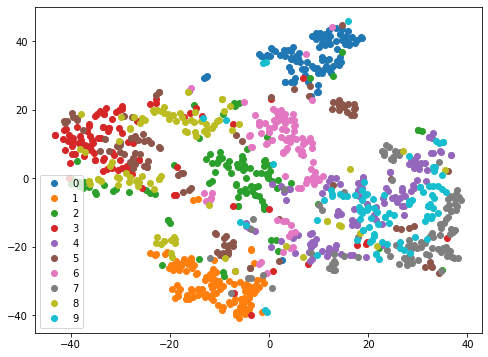

In [ ]:
from matplotlib import pyplot as plt
plt.figure(figsize=(8,6))
for c in np.unique(labels):
  plt.plot(codes_tsne[labels==c, 0], codes_tsne[labels==c, 1], 'o', label = c)
plt.legend()
plt.show()

In [ ]:

from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsClassifier
neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(codes_tsne, labels)
print("Accuracy di ",accuracy_score(labels,neigh.predict(codes_tsne)))


Accuracy di  0.872


In [ ]:
from torchvision.utils import make_grid

class ConvAutoencoder(pl.LightningModule):
  def __init__(self):
    super(ConvAutoencoder,self).__init__()
    self.encoder=nn.Sequential(nn.Conv2d(1,16,3,padding=1),
                               nn.AvgPool2d(2),
                               nn.ReLU(),
                               nn.Conv2d(16,8,3,padding=1),
                               nn.AvgPool2d(2),
                               nn.ReLU(),
                               nn.Conv2d(8,4,3,padding=1),
                               nn.ReLU())
    
    self.decoder=nn.Sequential(nn.Conv2d(4,8,3,padding=1),
                               nn.Upsample(scale_factor=2),
                               nn.ReLU(),
                               nn.Conv2d(8,16,3,padding=1),
                               nn.Upsample(scale_factor=2),
                               nn.ReLU(),
                               nn.Conv2d(16,1,3,padding=1))
    
    self.criterion=nn.MSELoss()

  def forward(self,x):
    code=self.encoder(x)
    rec=self.decoder(code)
    return code,rec

  def configure_optimizers(self):
    optimizer = SGD(self.parameters(), lr=0.01, momentum=0.99)
    return optimizer

  def training_step(self, train_batch, batch_idx):
    x, _ = train_batch
    _, reconstructed = self.forward(x)
    loss = self.criterion(x, reconstructed)

    self.log('train/loss', loss)
    return loss

  def validation_step(self, val_batch, batch_idx):
    x, _ = val_batch
    _, reconstructed = self.forward(x)
    loss = self.criterion(x, reconstructed)

    self.log('val/loss', loss)
    if batch_idx==0:
      return {'inputs':x, 'outputs':reconstructed}

    
  def validation_epoch_end(self, results):
    images_in = results[0]['inputs'].view(-1,1,28,28)[:50,...]
    images_out = results[0]['outputs'].view(-1,1,28,28)[:50,...]
    self.logger.experiment.add_image('input_images', make_grid(images_in, nrow=10,normalize=True),self.global_step)
    self.logger.experiment.add_image('generated_images', make_grid(images_out, nrow=10, normalize=True),self.global_step)



In [ ]:
from torchvision.datasets import MNIST
from torch.utils.data import DataLoader
from torchvision import transforms

def add_noise_image(img,size_h=5,size_w=5):
  # img_w,img_h=(28,28)
  # print("Dimensione immagine",img_w,img_h)

  weight=random.randint(10,20)
  height=random.randint(10,20)
  # print(weight)
  # print(height) 
  # # plt.imshow(img[weight:weight+size_w,height:height+size_h],cmap='gray')
  img[:,weight:weight+size_w,height:height+size_h]=0
  # plt.imshow(img,cmap='gray')
  # print(img.shape)

  return img
  # print(img[:50,:50])

transform = transforms.Compose([transforms.ToTensor(),
                                # transforms.Lambda(add_noise_image),
                                transforms.Normalize((0.1307,), (0.3081,))])
mnist_train = MNIST(root='mnist',train=True, download=True, transform=transform)
mnist_test = MNIST(root='mnist',train=False, download=True, transform=transform)
mnist_train_loader = DataLoader(mnist_train, batch_size=1024, num_workers=2, shuffle=True)
mnist_test_loader = DataLoader(mnist_test, batch_size=1024, num_workers=2)

In [ ]:
logger = TensorBoardLogger("tb_logs", name="mnist_conv_autoencoder")

mnist_conv_autoencoder = ConvAutoencoder()
trainer = pl.Trainer(max_epochs=5, gpus=0, logger=logger)
trainer.fit(mnist_conv_autoencoder, mnist_train_loader, mnist_test_loader)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 1.6 K 
1 | decoder   | Sequential | 1.6 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
3.2 K     Trainable params
0         Non-trainable params
3.2 K     Total params
0.013     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

In [ ]:
codes, labels = extract_codes(mnist_conv_autoencoder, mnist_test_loader)
print(codes.shape, labels.shape)

(10000, 4, 7, 7) (10000,)


In [ ]:
selected_codes = np.random.choice(len(codes),1000)
codes = codes.reshape(codes.shape[0],-1)
codes = codes[selected_codes]
labels = labels[selected_codes]
print(codes.shape)

(1000, 196)


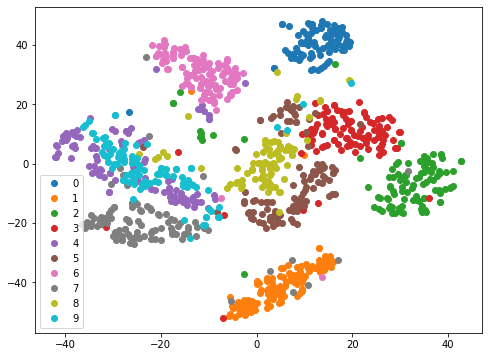

In [ ]:
tsne = TSNE(2)
codes_tsne_conv=tsne.fit_transform(codes)
plt.figure(figsize=(8,6))
for c in np.unique(labels):
  plt.plot(codes_tsne_conv[labels==c, 0], codes_tsne_conv[labels==c, 1], 'o', label= c)
plt.legend()
plt.show()

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsClassifier
neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(codes_tsne_conv, labels)
print("Accuracy di ",accuracy_score(labels,neigh.predict(codes_tsne_conv)))


Accuracy di  0.932


In [ ]:
from torchvision.utils import make_grid

class DenoisingConvAutoencoder(pl.LightningModule):
  def __init__(self):
    super(DenoisingConvAutoencoder, self).__init__()
    self.encoder = nn.Sequential(nn.Conv2d(1,16,3, padding=1),
    nn.AvgPool2d(2),
    nn.ReLU(),
    nn.Conv2d(16,8,3, padding=1),
    nn.AvgPool2d(2),
    nn.ReLU(),
    nn.Conv2d(8,4,3, padding=1),
    nn.ReLU())

    self.decoder = nn.Sequential(nn.Conv2d(4,8,3, padding=1),
    nn.Upsample(scale_factor=2),
    nn.ReLU(),
    nn.Conv2d(8,16,3, padding=1),
    nn.Upsample(scale_factor=2),
    nn.ReLU(),
    nn.Conv2d(16,1,3, padding=1))

    self.criterion = nn.MSELoss()

  def forward(self, x, perturb=False):
  #utilizziamo un parametro perturb per stabilire
  #se l'input va perturbato oppure no
    if perturb:
    #Aggiungiamo del rumore random compreso tra -0.5 e 0.5
    #moltiplichiamo per un fattore di rumore che indica quanto
    #il rumore deve essere presente nell'immagine finale
      ##RUMORE
      #noise_factor = 0.5
      #x = x + (torch.randn_like(x)-0.5) * noise_factor
      ##CROP
      weight=random.randint(8,15)
      height=random.randint(8,15)
      # # print(x.shape)
      # x[:,:,weight:weight+5,height:height+5]=0
      d=x.clone()
      d[:,:,weight:weight+5,height:height+5]=0

      




    code = self.encoder(x)
    reconstructed = self.decoder(code)
    #restituiamo anche l'immagine perturbata
    #tornerà utile per le visualizzazioni
    if perturb:
      return code,reconstructed,d
      
    return code, reconstructed, x

  # questo metodo definisce l'optimizer
  def configure_optimizers(self):
    optimizer = SGD(self.parameters(), lr=0.01, momentum=0.99)
    return optimizer

  # questo metodo definisce come effettuare ogni singolo step di training
  def training_step(self, train_batch, batch_idx):
    x, _ = train_batch
    _, reconstructed, perturbed = self.forward(x, perturb=True)
    loss = self.criterion(perturbed, reconstructed)

    self.log('train/loss', loss)
    return loss

  # questo metodo definisce come effettuare ogni singolo step di validation
  def validation_step(self, val_batch, batch_idx):
    x, _ = val_batch
    _, reconstructed, perturbed = self.forward(x, perturb=True)
    loss = self.criterion(perturbed, reconstructed)

    self.log('val/loss', loss)
    if batch_idx==0:
      return {'inputs':x, 'perturbed': perturbed, 'outputs':reconstructed}

  def validation_epoch_end(self, results):
    images_in = results[0]['inputs'].view(-1,1,28,28)[:50,...]
    perturbed = results[0]['perturbed'].view(-1,1,28,28)[:50,...]
    images_out = results[0]['outputs'].view(-1,1,28,28)[:50,...]
    self.logger.experiment.add_image('original_images', make_grid(images_in, nrow=10, normalize=True),self.global_step)
    self.logger.experiment.add_image('perturbed_images', make_grid(perturbed, nrow=10, normalize=True),self.global_step)
    self.logger.experiment.add_image('generated_images', make_grid(images_out, nrow=10, normalize=True),self.global_step)



In [ ]:
%load_ext tensorboard
%tensorboard --logdir tb_logs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 3571), started 0:15:39 ago. (Use '!kill 3571' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
mnist_denoising_conv_autoencoder = DenoisingConvAutoencoder()

In [ ]:
logger = TensorBoardLogger("tb_logs", name="1")


trainer = pl.Trainer(max_epochs=5, gpus=0, logger=logger)
trainer.fit(mnist_denoising_conv_autoencoder, mnist_train_loader, mnist_test_loader)

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 1.6 K 
1 | decoder   | Sequential | 1.6 K 
2 | criterion | MSELoss    | 0     
-----------------------------------------
3.2 K     Trainable params
0         Non-trainable params
3.2 K     Total params
0.013     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

torch.Size([1, 4, 7, 7]) torch.Size([1, 1, 28, 28]) torch.Size([1, 1, 28, 28])


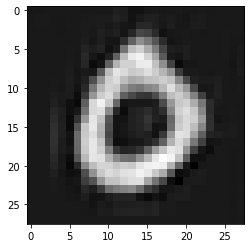

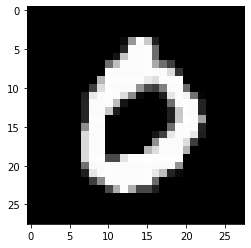

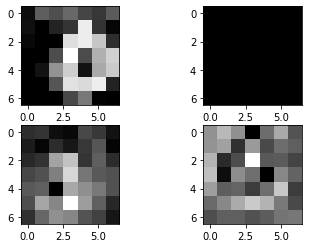

In [ ]:
###TESTING MODEL

for loader in mnist_test_loader:
  img=(loader[0][3])
  plt.imshow(img.reshape(28,28),cmap='gray')
  break

cod,rec,original=mnist_denoising_conv_autoencoder(img.reshape(-1,1,28,28))
print(cod.shape,rec.shape,original.shape)
plt.imshow(rec.detach().reshape(28,28),cmap='gray')
plt.show()
plt.imshow(original.detach().reshape(28,28),cmap='gray')
plt.show()

fig,axes=plt.subplots(2,2)

axes[0][0].imshow(cod[0][0].detach(),cmap='gray')
axes[0][1].imshow(cod[0][1].detach(),cmap='gray')
axes[1][0].imshow(cod[0][2].detach(),cmap='gray')
axes[1][1].imshow(cod[0][3].detach(),cmap='gray')

In [ ]:
from PIL import Image

img=Image.open('test.png').convert('L')
print(type(np.asarray(img)))
img=torch.Tensor(np.asarray(img).reshape(1,28,28))
print(img.shape)

img=img-0.13/0.30


cod,rec,original=mnist_denoising_conv_autoencoder(img.reshape(-1,1,28,28))
print(cod.shape,rec.shape,original.shape)
plt.imshow(rec.detach().reshape(28,28),cmap='gray')
plt.show()
plt.imshow(original.detach().reshape(28,28),cmap='gray')
plt.show()

fig,axes=plt.subplots(2,2)

axes[0][0].imshow(cod[0][0].detach(),cmap='gray')
axes[0][1].imshow(cod[0][1].detach(),cmap='gray')
axes[1][0].imshow(cod[0][2].detach(),cmap='gray')
axes[1][1].imshow(cod[0][3].detach(),cmap='gray')




FileNotFoundError: ignored

In [ ]:
def extract_codes_denoising(model,loader):
  device = "cuda" if torch.cuda.is_available() else "cpu"
  model.to(device)
  codes,labels=[],[]
  recs=[]
  for batch in loader:
    x=batch[0].to(device)
    code,rec,_= model(x)
    code=code.detach().to('cpu').numpy()
    # rec=rec.detach().to('cpu').numpy()
    labels.append(batch[1])
    codes.append(code)
    # recs.append(rec)

  # print(rec.shape)
  # print(len(np.concatenate(labels)))
  #print(len(recs[0]))
  #print("Accuracy",accuracy_score(np.concatenate(recs),np.concatenate(labels)))
  return np.concatenate(codes),np.concatenate(labels)
  

# extract_codes_denoising(mnist_denoising_conv_autoencoder, mnist_test_loader)

In [ ]:
import matplotlib.pyplot as plt

codes, labels = extract_codes_denoising(mnist_denoising_conv_autoencoder, mnist_test_loader)
selected_codes = np.random.choice(len(codes),1000)
codes = codes.reshape(codes.shape[0],-1)
codes = codes[selected_codes]
labels = labels[selected_codes]
tsne = TSNE(2)
codes_tsne_conv_denoising=tsne.fit_transform(codes)
plt.figure(figsize=(8,6))

for c in np.unique(labels):
  plt.plot(codes_tsne_conv_denoising[labels==c, 0], codes_tsne_conv_denoising[labels==c, 1], 'o', label = c)
plt.legend()
plt.show()

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.neighbors import KNeighborsClassifier
neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(codes_tsne_conv_denoising, labels)


neigh = KNeighborsClassifier(n_neighbors=3)
neigh.fit(codes, labels)

print("Accuracy di ",accuracy_score(labels,neigh.predict(codes)))
print("Accuracy di ",accuracy_score(labels,neigh.predict(codes_tsne_conv_denoising)))

In [ ]:
from torchvision.utils import make_grid
class SparseConvAutoencoder(pl.LightningModule):
  def __init__(self):
    super(SparseConvAutoencoder, self).__init__()
    self.encoder = nn.Sequential(nn.Conv2d(1,16,3, padding=1),
    nn.AvgPool2d(2),
    nn.ReLU(),
    nn.Conv2d(16,8,3, padding=1),
    nn.AvgPool2d(2),
    nn.ReLU(),
    nn.Conv2d(8,4,3, padding=1),
    nn.ReLU())

    self.decoder = nn.Sequential(nn.Conv2d(4,8,3, padding=1),
    nn.Upsample(scale_factor=2),
    nn.ReLU(),
    nn.Conv2d(8,16,3, padding=1),
    nn.Upsample(scale_factor=2),
    nn.ReLU(),
    nn.Conv2d(16,1,3, padding=1))

    #la loss che utilizzeremo per il training
    self.criterion = nn.MSELoss()
    self.l1 = nn.L1Loss()

    self.s = 0.05
    self.beta = 0.5

  def forward(self, x):
    code = self.encoder(x)
    reconstructed = self.decoder(code)
    return code, reconstructed

# questo metodo definisce l'optimizer
  def configure_optimizers(self):
    optimizer = SGD(self.parameters(), lr=0.01, momentum=0.99)
    return optimizer

# questo metodo definisce come effettuare ogni singolo step di training
  def training_step(self, train_batch, batch_idx):
    x, _ = train_batch
    code, reconstructed = self.forward(x)

  #definiamo il vincolo di sparsità
  #mediante loss l1
    sparse_loss = self.l1(torch.ones_like(code)*self.s, code)
    #sommiamo la loss MSE alla loss di sparsità moltiplicata per beta
    loss = self.criterion(x, reconstructed) + self.beta * sparse_loss

    self.log('train/loss', loss)
    return loss

# questo metodo definisce come effettuare ogni singolo step di validation
  def validation_step(self, val_batch, batch_idx):
    x, _ = val_batch
    _, reconstructed = self.forward(x)
    loss = self.criterion(x, reconstructed)

    self.log('val/loss', loss)
    if batch_idx==0:
      return {'inputs':x, 'outputs':reconstructed}
  
  def validation_epoch_end(self, results):
      images_in = results[0]['inputs'].view(-1,1,28,28)[:50,...]
      images_out = results[0]['outputs'].view(-1,1,28,28)[:50,...]
      self.logger.experiment.add_image('input_images', make_grid(images_in, nrow=10,normalize=True),self.global_step)
      self.logger.experiment.add_image('generated_images', make_grid(images_out, nrow=10, normalize=True),self.global_step)

In [ ]:
logger = TensorBoardLogger("tb_logs", name="mnist_sparse_conv_autoencoder")
mnist_sparse_conv_autoencoder = SparseConvAutoencoder()
trainer = pl.Trainer(max_epochs=10, gpus=1, logger=logger)
trainer.fit(mnist_sparse_conv_autoencoder, mnist_train_loader, mnist_test_loader)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name      | Type       | Params
-----------------------------------------
0 | encoder   | Sequential | 1.6 K 
1 | decoder   | Sequential | 1.6 K 
2 | criterion | MSELoss    | 0     
3 | l1        | L1Loss     | 0     
-----------------------------------------
3.2 K     Trainable params
0         Non-trainable params
3.2 K     Total params
0.013     Total estimated model params size (MB)


Validation sanity check: 0it [00:00, ?it/s]

Training: -1it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

Validating: 0it [00:00, ?it/s]

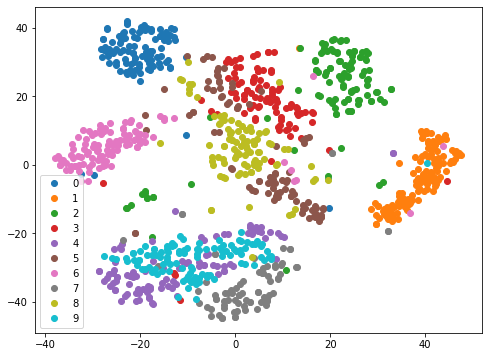

In [ ]:
codes, labels = extract_codes(mnist_sparse_conv_autoencoder, mnist_test_loader)
selected_codes = np.random.choice(len(codes),1000)
codes = codes.reshape(codes.shape[0],-1)
codes = codes[selected_codes]
labels = labels[selected_codes]
tsne = TSNE(2)
codes_tsne_conv_sparse=tsne.fit_transform(codes)
plt.figure(figsize=(8,6))
for c in np.unique(labels):
  plt.plot(codes_tsne_conv_sparse[labels==c, 0], codes_tsne_conv_sparse[labels==c,1], 'o', label = c)
plt.legend()
plt.show()

<class 'numpy.ndarray'>
torch.Size([1, 28, 28])
torch.Size([1, 4, 7, 7]) torch.Size([1, 1, 28, 28]) torch.Size([1, 1, 28, 28])


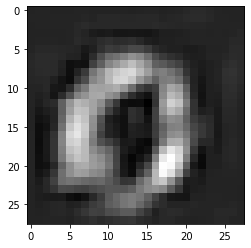

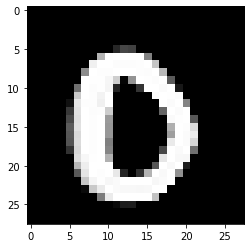

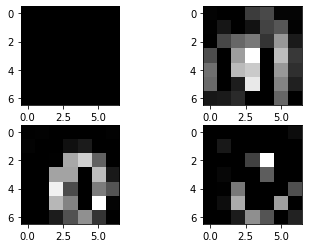

In [ ]:
from PIL import Image

img=Image.open('test.png').convert('L')
print(type(np.asarray(img)))
img=torch.Tensor(np.asarray(img).reshape(1,28,28))
print(img.shape)

img=img-0.13/0.30
img.to('cuda')
mnist_sparse_conv_autoencoder.to('cpu')

cod,rec=mnist_sparse_conv_autoencoder(img.reshape(-1,1,28,28))
rec=rec*0.3081 + 0.1307
print(cod.shape,rec.shape,original.shape)
plt.imshow(rec.detach().reshape(28,28),cmap='gray')
plt.show()
plt.imshow(original.detach().reshape(28,28),cmap='gray')
plt.show()

fig,axes=plt.subplots(2,2)

axes[0][0].imshow(cod[0][0].detach(),cmap='gray')
axes[0][1].imshow(cod[0][1].detach(),cmap='gray')
axes[1][0].imshow(cod[0][2].detach(),cmap='gray')
axes[1][1].imshow(cod[0][3].detach(),cmap='gray')

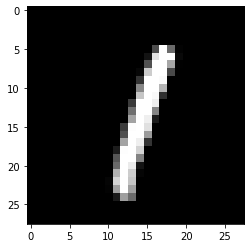

torch.Size([1, 4, 7, 7]) torch.Size([1, 1, 28, 28]) torch.Size([1, 1, 28, 28])


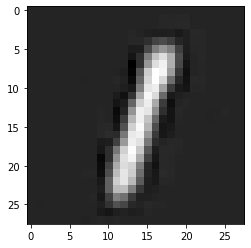

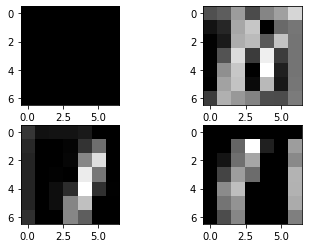

In [ ]:
for loader in mnist_test_loader:
  img=(loader[0][5])
  plt.imshow(img.reshape(28,28),cmap='gray')
  plt.show()
  break

img.to('cpu')
mnist_sparse_conv_autoencoder.to('cpu')
cod,rec=mnist_sparse_conv_autoencoder(img.reshape(-1,1,28,28))
rec=rec*0.3081 + 0.1307
print(cod.shape,rec.shape,original.shape)
plt.imshow(rec.detach().reshape(28,28),cmap='gray')
plt.show()


fig,axes=plt.subplots(2,2)

axes[0][0].imshow(cod[0][0].detach(),cmap='gray')
axes[0][1].imshow(cod[0][1].detach(),cmap='gray')
axes[1][0].imshow(cod[0][2].detach(),cmap='gray')
axes[1][1].imshow(cod[0][3].detach(),cmap='gray')

In [ ]:
#####ESEMPI

In [ ]:
codes_train, labels_train = extract_codes(mnist_sparse_conv_autoencoder, mnist_train_loader)
codes_train = codes_train.reshape(codes_train.shape[0],-1)
selected_codes = np.random.choice(len(codes),100)
codes_train = codes[selected_codes]
labels_train = labels[selected_codes]
codes_test, labels_test = extract_codes(mnist_sparse_conv_autoencoder, mnist_test_loader)
codes_test = codes_test.reshape(codes_test.shape[0],-1)

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=1)
knn.fit(codes_train, labels_train)
knn.score(codes_test, labels_test)

0.7174

In [ ]:
images_train = np.vstack([mnist_train[i][0].view(-1) for i in selected_codes])
labels_train = np.hstack([mnist_train[i][1] for i in selected_codes])
images_test = np.vstack([mnist_test[i][0].view(-1) for i in range(len(mnist_test))])
labels_test = np.hstack([mnist_test[i][1] for i in range(len(mnist_test))])

In [ ]:
knn = KNeighborsClassifier(n_neighbors=1)
knn.fit(images_train, labels_train)
knn.score(images_test, labels_test)

0.7003

In [ ]:
for batch in mnist_test_loader:
  break
batch[0].shape

torch.Size([1024, 1, 28, 28])

In [ ]:
transform = transforms.Compose([transforms.ToTensor(),
transforms.Normalize((0.1307,), (0.3081,)),torch.flatten])
mnist_test = MNIST(root='mnist',train=False, download=True, transform=transform)
mnist_test_loader = DataLoader(mnist_test, batch_size=1024, num_workers=2)
codes_test, labels_test = extract_codes(mnist_autoencoder, mnist_test_loader)
#rappresentiamo le immagini a 8 bit
mnist_test_raw = MNIST(root='mnist',train=False, download=True, \
transform=transforms.Compose([transforms.ToTensor(), transforms.Lambda(lambda x: x*255)]))
images_test_raw = np.vstack([mnist_test_raw[i][0].view(-1) for i in range(len(mnist_test_raw))]).astype(np.uint8)

In [ ]:
print(f"Dimensione occupata dalle immagini: {images_test_raw.nbytes}")
print(f"Dimensione occupata dai codici: {codes_test.nbytes}")
print(f"Rapporto di compressione: {100-codes_test.nbytes/images_test_raw.nbytes*100:0.2f}%")

Dimensione occupata dalle immagini: 7840000
Dimensione occupata dai codici: 5120000
Rapporto di compressione: 34.69%


In [ ]:
decoder = mnist_autoencoder.decoder

In [ ]:
def decode(code):
  output_image = decoder(code)
  #l'immagine in output è normalizzata come quelle che abbiamo passato in input
  #invertiamo la normalizzazione:
  return output_image*0.3081 + 0.1307

In [ ]:
out_img=(torch.from_numpy(codes_test.copy()).cuda()).reshape(-1,1,28,28)
plt.imshow(out_img[0][0].detach().cpu(), cmap='gray')

RuntimeError: ignored

In [ ]:
from torchvision.datasets import FashionMNIST
transform = transforms.Compose([transforms.ToTensor(),
transforms.Normalize((0.1307,), (0.3081,))])
fashion_train = FashionMNIST(root='fashion', download=True, transform=transform)
fashion_train_loader = DataLoader(fashion_train, batch_size=1024)

In [ ]:
im_in_fashion = fashion_train[5][0]
code, im_out_fashion = mnist_conv_autoencoder(im_in_fashion.unsqueeze(0).cuda())
plt.subplot(1,2,1)
plt.imshow(im_in_fashion.squeeze().detach(), cmap='gray')
plt.subplot(1,2,2)
plt.imshow(im_out_fashion.squeeze().cpu().detach(), cmap='gray')
print(f"Distanza fra le immagini: {(im_in_fashion.cpu()-im_out_fashion.cpu()).norm(2):0.2f}")

In [ ]:
im_in_mnist = mnist_train[7][0]
code, im_out_mnist = mnist_conv_autoencoder(im_in_mnist.unsqueeze(0).cuda())
plt.subplot(1,2,1)
plt.imshow(im_in_mnist.squeeze().detach(), cmap='gray')
plt.subplot(1,2,2)
plt.imshow(im_out_mnist.squeeze().cpu().detach(), cmap='gray')
print(f"Distanza fra le immagini: {(im_in_mnist.cpu()-im_out_mnist.cpu()).norm(2):0.2
f}")

In [ ]:
from tqdm import tqdm
norms_fashion=[]
for im, _ in tqdm(fashion_train_loader):
  _, im_out = mnist_conv_autoencoder(im.cuda())
  n=(im-im_out.cpu()).view(im.shape[0],-1).norm(2, dim=-1)
  norms_fashion.append(n.detach().numpy())
norms_fashion = np.concatenate(norms_fashion)
print("Media delle norme L2 per FashionMNIST:",norms_fashion.mean())

In [ ]:
norms_mnist=[]
for im, _ in tqdm(mnist_train_loader):
  _, im_out = mnist_conv_autoencoder(im.cuda())
  n=(im-im_out.cpu()).view(im.shape[0],-1).norm(2, dim=-1)
  norms_mnist.append(n.detach().numpy())
norms_mnist = np.concatenate(norms_mnist)
print("Media delle norme L2 per MNIST:",norms_mnist.mean())

In [ ]:
plt.figure()
plt.boxplot([norms_fashion, norms_mnist], positions=[0,1])
plt.grid()
plt.show(

In [ ]:
from sklearn.linear_model import LogisticRegression
#gli elementi in input saranno tutte le norme L2
x_train = np.concatenate([
norms_fashion,
norms_mnist
]).reshape(-1,1)
#definiamo le etichette
y_train = np.concatenate([
np.ones_like(norms_fashion)*-1, #negative examples: fashion
np.ones_like(norms_mnist),#positive examples
]).reshape(-1,1)
lr = LogisticRegression()
lr.fit(x_train, y_train)

In [ ]:
def detect_anomaly(example):
  _, im_out = mnist_conv_autoencoder(example.unsqueeze(0).cuda())

  return lr.predict((im_out.cpu()-example).norm(2).detach().numpy().reshape(-1,1))


In [ ]:
transform = transforms.Compose([transforms.ToTensor(),
transforms.Normalize((0.1307,), (0.3081,))])
mnist_test = MNIST(root='mnist',train=False, download=True, transform=transform)
fashion_test = FashionMNIST(root='fashion', train=False, download=True, transform=transform)

In [ ]:
predictions_mnist = []
predictions_fashion = []
for i in tqdm(np.random.choice(len(mnist_test), 1000)):
  prediction_mnist = detect_anomaly(mnist_test[i][0])
  prediction_fashion = detect_anomaly(fashion_test[i][0])
  predictions_mnist.append(prediction_mnist)
  predictions_fashion.append(prediction_fashion)
  predictions_mnist = np.array(predictions_mnist)
  predictions_fashion = np.array(predictions_fashion)
print(f"Percentuale di elementi di MNIST classificati correttamente: {(predictions_mnist==1).mean()*100:0.2f}%")
print(f"Percentuale di elementi di Fashion-MNIST classificati correttamente: {(predictions_fashion==-1).mean()*100:0.2f}%")